- https://towardsdatascience.com/deep-learning-based-super-resolution-with-opencv-4fd736678066

- https://learnopencv.com/super-resolution-in-opencv/

- https://alexanderell.is/posts/rgb-color-space/ 

- https://stackoverflow.com/questions/72193940/how-to-automatically-determine-the-background-color-of-an-rgba-image-with-highes 

- 

In [1]:
from PIL import Image, ImageEnhance
import math

In [2]:
import numpy as np
from sklearn.cluster import KMeans

In [3]:
import cv2

In [4]:
from matplotlib import pyplot as plt

In [6]:
pwd()

'/mnt/e/ADB_Project/github/adb-jobs-analysis/notebooks'

In [5]:
image_file = r"E:/ADB_Project/code/data/cs_sample/600087.png"
img = cv2.imread(image_file)

In [6]:
image1_file = r"E:/ADB_Project/code/data/cs_sample/602769.png"
img1 = cv2.imread(image1_file)

In [7]:
import pytesseract

# loading pytesseract 
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract'

In [8]:
def display(im_path):
    dpi = 80
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()
    

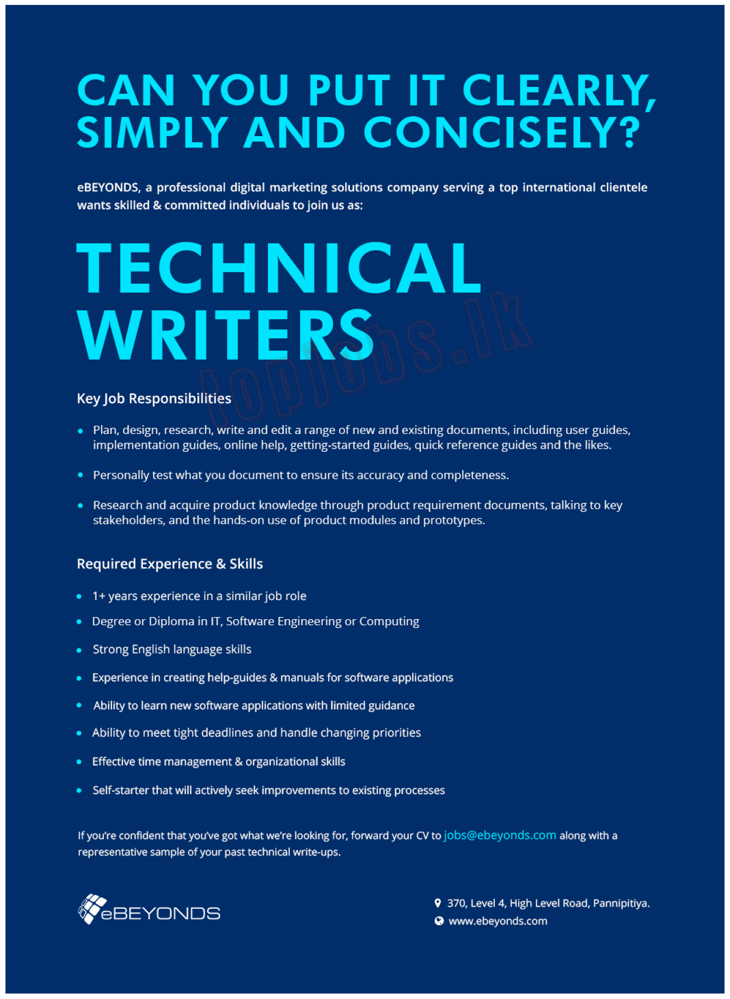

In [9]:
display(image1_file)

## 01: Inverted Images

In [10]:
def get_colors(cluster, centroids, exact=False):
    """for a given image, get all the colors and their percentages"""
    # Get the number of different clusters, create histogram, and normalize
    labels = np.arange(0, len(np.unique(cluster.labels_)) + 1)
    (hist, _) = np.histogram(cluster.labels_, bins = labels)
    hist = hist.astype("float")
    hist /= hist.sum()
    
    # Convert each RGB color code from float to int
    if not exact:
        centroids = centroids.astype("int")
    
    # get the colors of the image
    colors = sorted([(percent, color) for (percent, color) in zip(hist, centroids)])

    return colors

In [11]:
def is_dark(image):
    """cheks whether the dominant color of the image is dark"""
    
    #converts the image to a list of pixels
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    reshape = image.reshape((image.shape[0] * image.shape[1], 3))
    
    # Find and display most X dominant colors
    cluster = KMeans(n_clusters=5).fit(reshape)
    colors = get_colors(cluster, cluster.cluster_centers_)
    
    # Obtain dominant RGB color code
    dominant_color = colors[-1][1].tolist()
    dominant_color_average = int(sum(dominant_color) / 3)
    
    # dominant_color_average <= 85: -> Dark/Black
    # dominant_color_average > 85 and dominant_color_average <= 170 -> in between
    # dominant_color_average > 170: Light/White
    
    #return dominant color
    if dominant_color_average <= 85:
        return True
    else:
        return False

In [12]:
def inversion(img):
    if is_dark(img):
        return cv2.bitwise_not(img)
    else:
        return img

In [13]:
inverted_image = inversion(img)

In [14]:
inverted_image1 = inversion(img1)

In [15]:
cv2.imwrite("temp/inverted.jpg", inverted_image)
cv2.imwrite("temp/inverted1.jpg", inverted_image1)


True

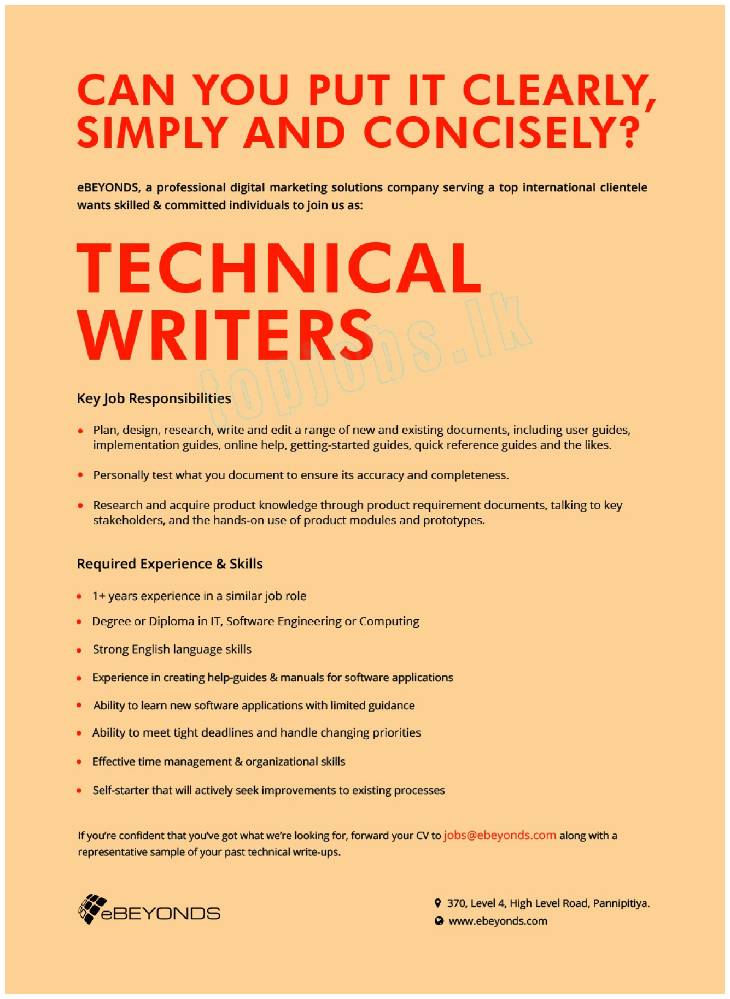

In [16]:
display("temp/inverted1.jpg")

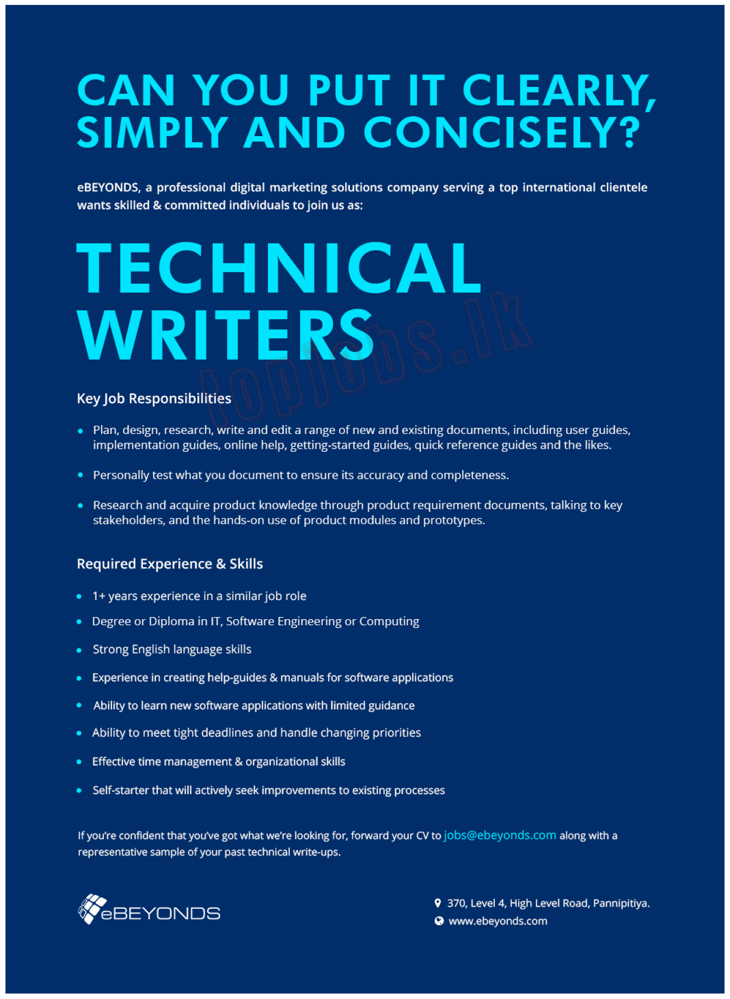

In [17]:
display(image1_file)

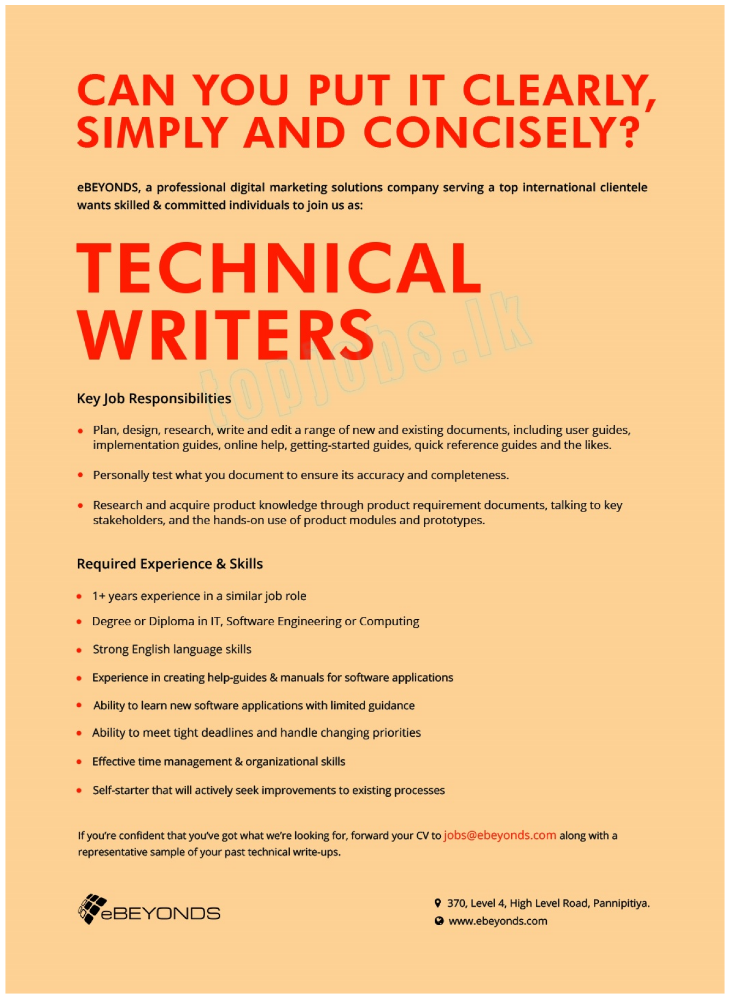

In [18]:
display("temp/inverted1.jpg")

## 02: Rescaling

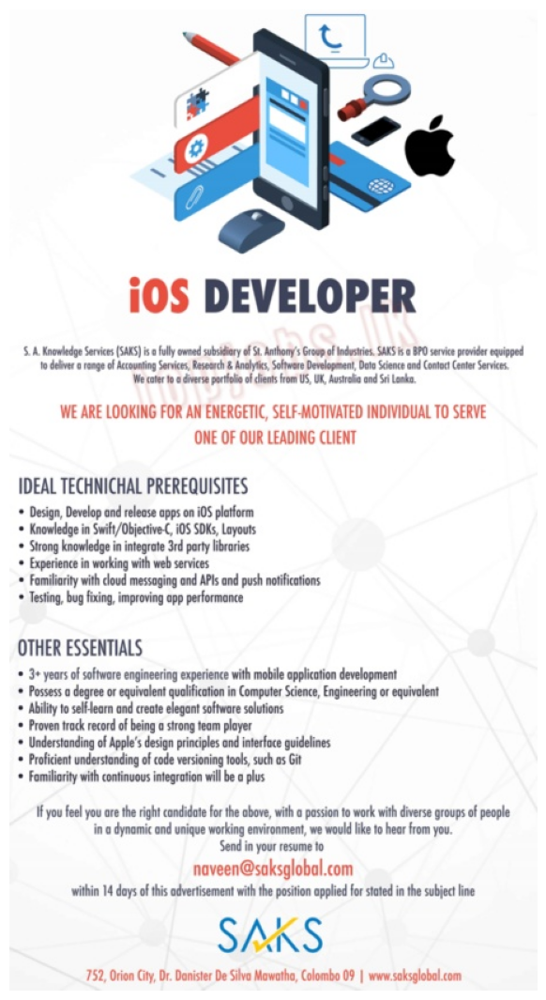

In [14]:
lwr1 = cv2.pyrDown(img)
cv2.imwrite("temp/low-res.jpg", lwr1)
display("temp/low-res.jpg")

In [13]:
# sr = cv2.dnn_superres.DnnSuperResImpl_create()
# path = "..\models/EDSR_x4.pb"
# sr.readModel(path)
# sr.setModel("edsr", 4)

In [14]:
# result = sr.upsample(hir1)

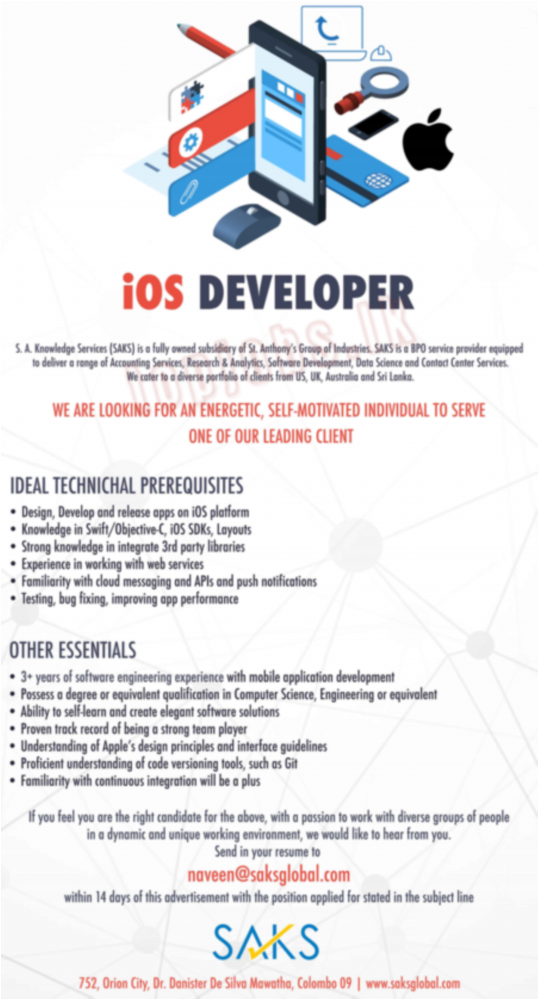

In [18]:
# cv2.imwrite("temp/edsr-upscaled.jpg", result)
# display("temp/edsr-upscaled.jpg")

In [17]:
sr = cv2.dnn_superres.DnnSuperResImpl_create()
path = r"E:/ADB_Project/github/adb-jobs-analysis/models/ESPCN_x3.pb"

sr.readModel(path)
sr.setModel("espcn", 3)

In [20]:
result_sr1 = sr.upsample(img1)

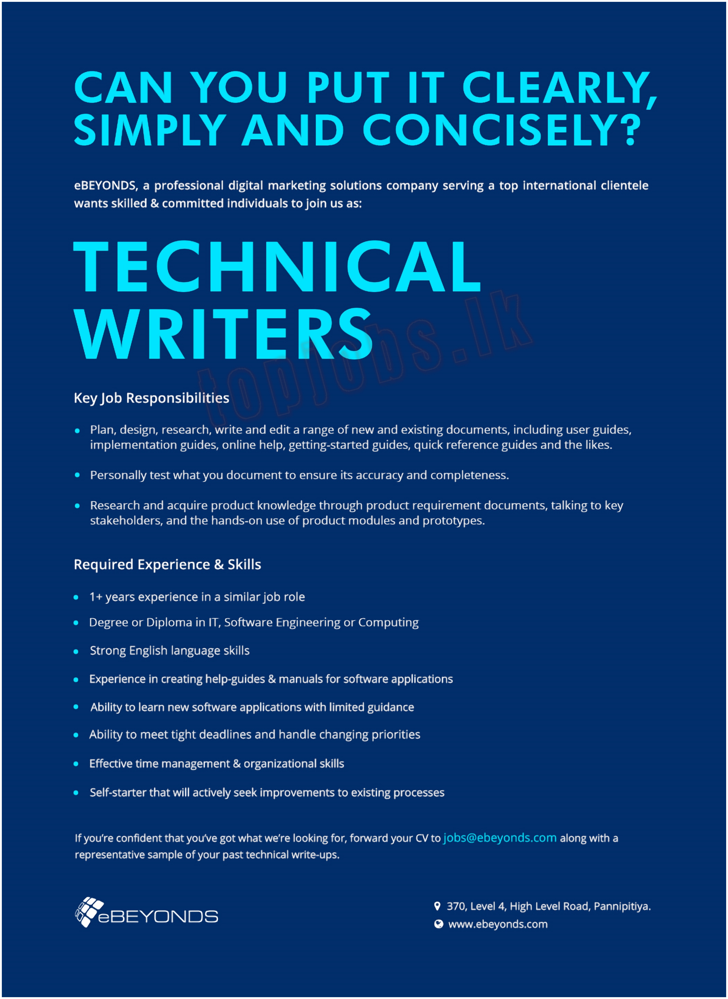

In [21]:
cv2.imwrite("temp/sr-upscaled-1.jpg", result_sr1)
display("temp/sr-upscaled-1.jpg")

- https://learnopencv.com/super-resolution-in-opencv/#sec2



- https://www.section.io/engineering-education/image-adjustment-to-higher-or-lower-resolution-using-python/#scaling-up-the-images-to-higher-resolutions 

## 03: Binarization

In [22]:
def grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#### Greying

In [25]:
gray_image1 = grayscale(inverted_image1)
cv2.imwrite("temp/gray1.jpg", gray_image1)

True

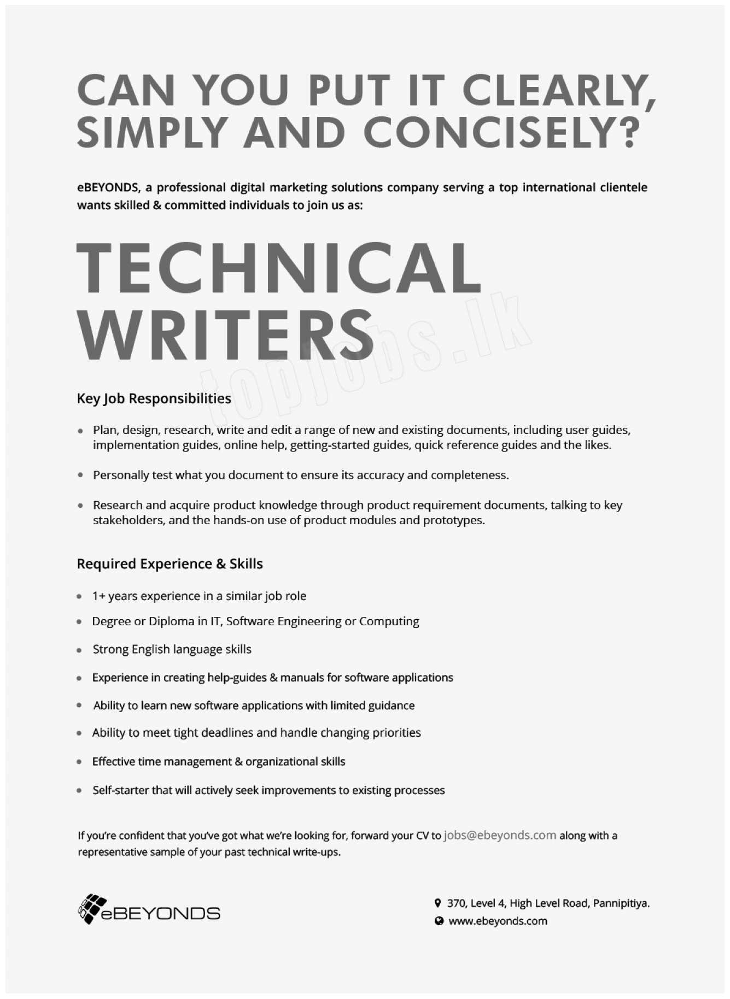

In [26]:
display("temp/gray1.jpg")

#### Black and White 

In [20]:
thresh, im_bw = cv2.threshold(gray_image, 210, 230, cv2.THRESH_BINARY)
cv2.imwrite("temp/bw_image.jpg", im_bw)

True

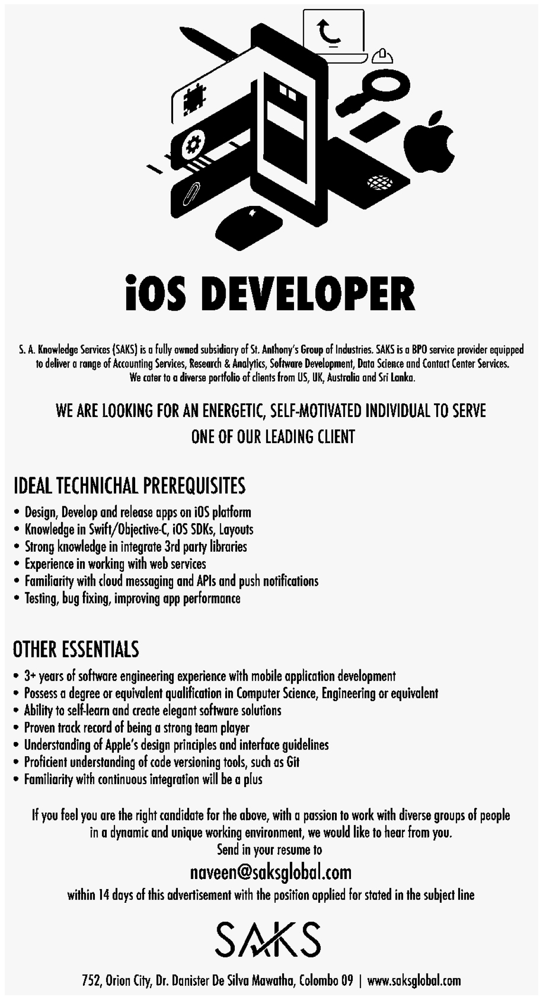

In [21]:
display("temp/bw_image.jpg")

## 04. Noise Removal

In [28]:
def noise_removal(image):
    import numpy as np
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    kernel = np.ones((1, 1), np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    image = cv2.medianBlur(image, 3)
    return (image)

In [29]:
no_noise = noise_removal(im_bw)
cv2.imwrite("temp/no_noise.jpg", no_noise)

True

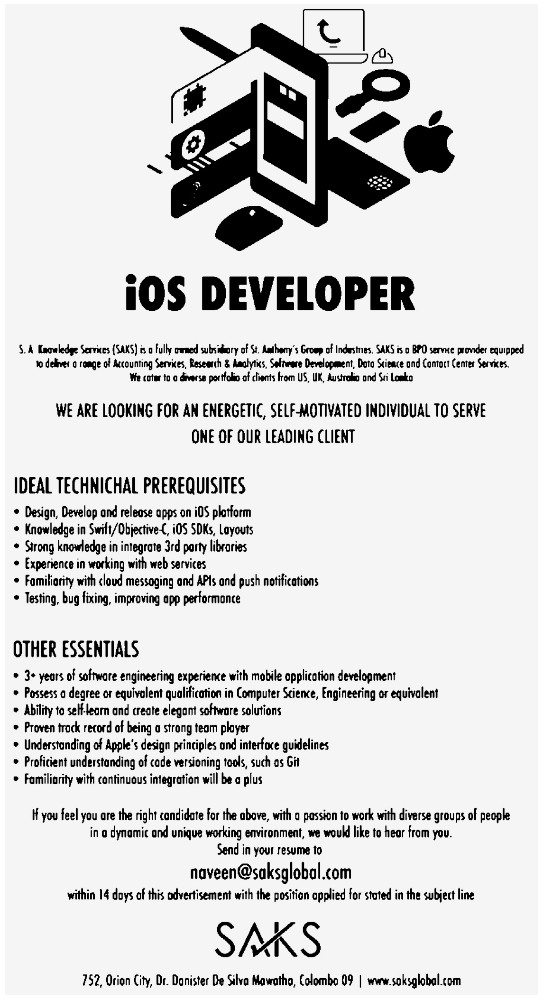

In [31]:
display("temp/no_noise.jpg")

## 05. Dilation and Erosion

#### Erosion

In [22]:
def thin_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.erode(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [23]:
eroded_image = thin_font(img)
cv2.imwrite("temp/eroded_image.jpg", eroded_image)

True

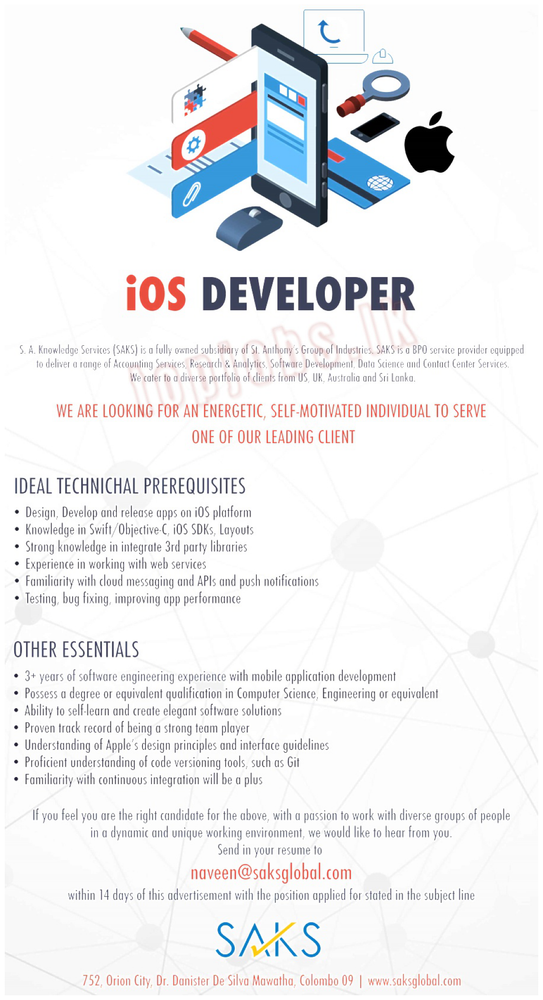

In [24]:
display("temp/eroded_image.jpg")

#### Dilation

In [28]:
def thick_font(image):
    import numpy as np
    image = cv2.bitwise_not(image)
    kernel = np.ones((2,2),np.uint8)
    image = cv2.dilate(image, kernel, iterations=1)
    image = cv2.bitwise_not(image)
    return (image)

In [29]:
dilated_image1 = thick_font(gray_image1)
cv2.imwrite("temp/dilated_image1.jpg", dilated_image1)

True

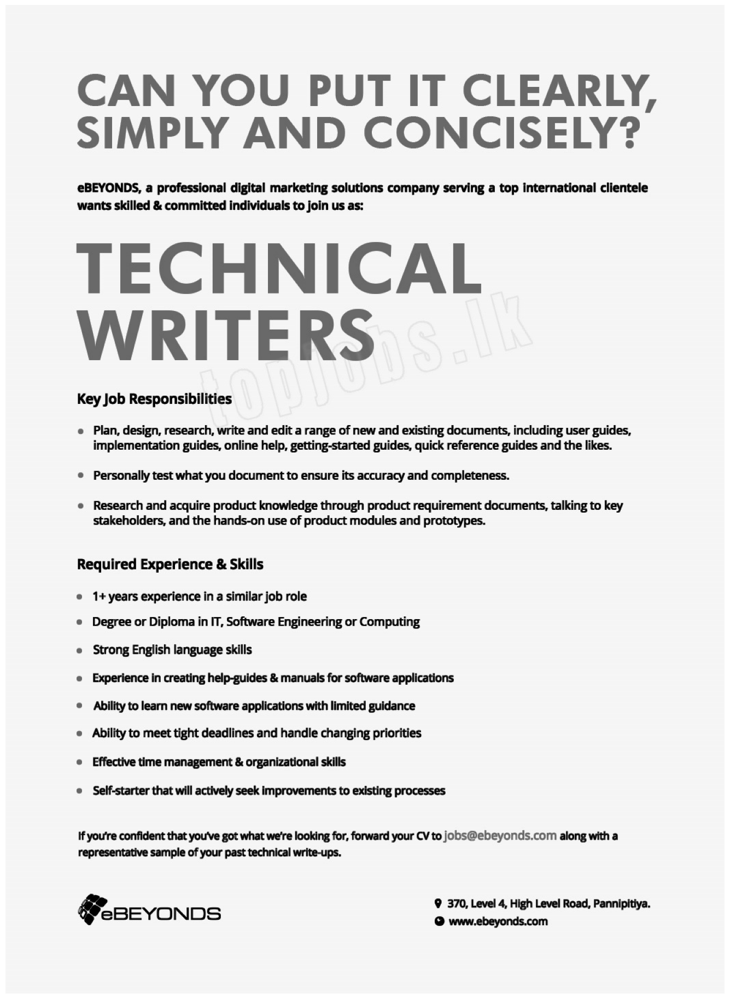

In [30]:
display("temp/dilated_image1.jpg")

## 06: Rotation / Deskewing

In [32]:
import numpy as np

def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (30, 5))
    dilate = cv2.dilate(thresh, kernel, iterations=2)

    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)
    for c in contours:
        rect = cv2.boundingRect(c)
        x,y,w,h = rect
        cv2.rectangle(newImage,(x,y),(x+w,y+h),(0,255,0),2)

    # Find largest contour and surround in min area box
    largestContour = contours[0]
    print (len(contours))
    minAreaRect = cv2.minAreaRect(largestContour)
    cv2.imwrite("temp/boxes.jpg", newImage)
    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return -1.0 * angle
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [33]:
# Deskew image
def deskew(cvImage):
    angle = getSkewAngle(cvImage)
    return rotateImage(cvImage, -1.0 * angle)

In [34]:
#fixed = deskew(new)
#cv2.imwrite("temp/rotated_fixed.jpg", fixed)

## 07: Removing Borders

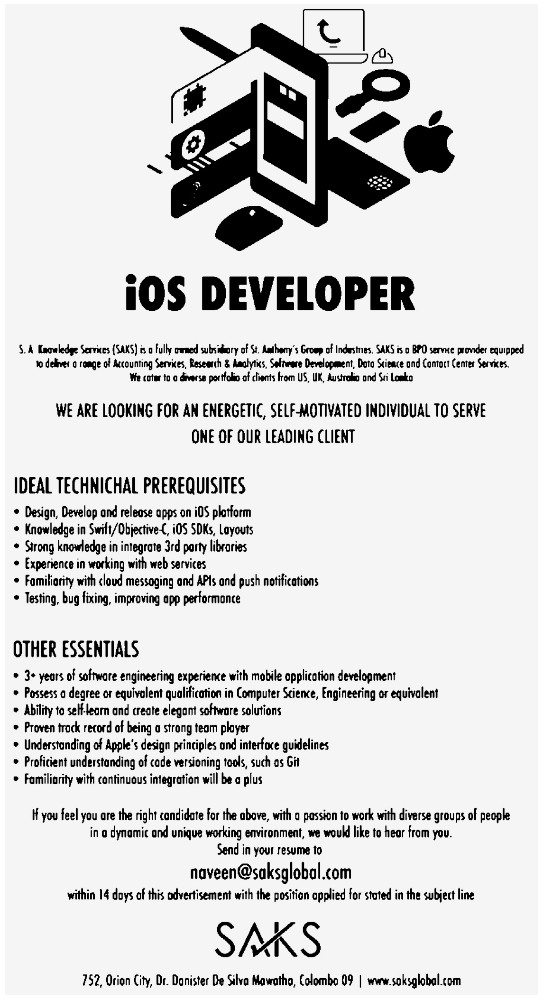

In [35]:
display("temp/no_noise.jpg")

In [36]:
def remove_borders(image):
    contours, heiarchy = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cntsSorted = sorted(contours, key=lambda x:cv2.contourArea(x))
    cnt = cntsSorted[-1]
    x, y, w, h = cv2.boundingRect(cnt)
    crop = image[y:y+h, x:x+w]
    return (crop)

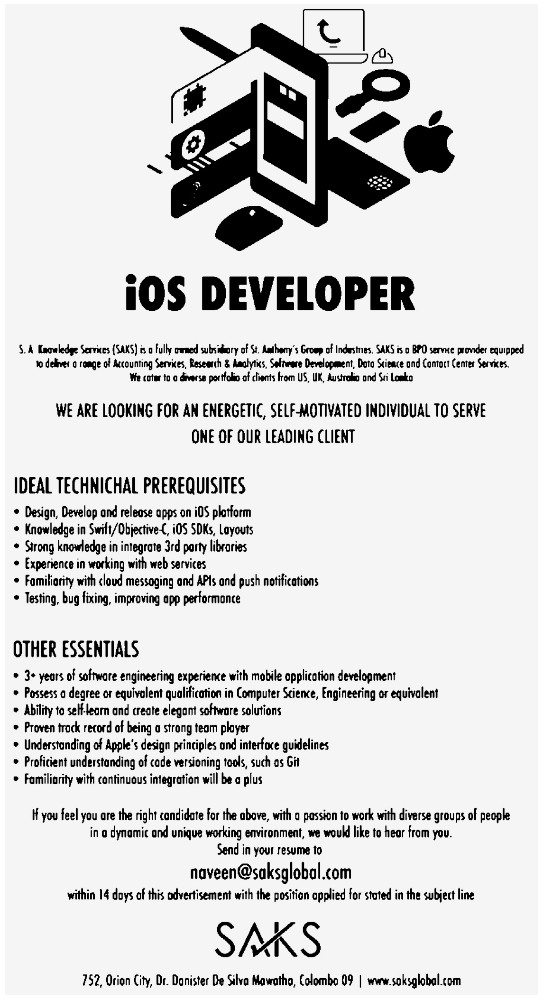

In [37]:
no_borders = remove_borders(no_noise)
cv2.imwrite("temp/no_borders.jpg", no_borders)
display('temp/no_borders.jpg')

## 08: Missing Borders

In [42]:
color = [255, 255, 255]
top, bottom, left, right = [150]*4

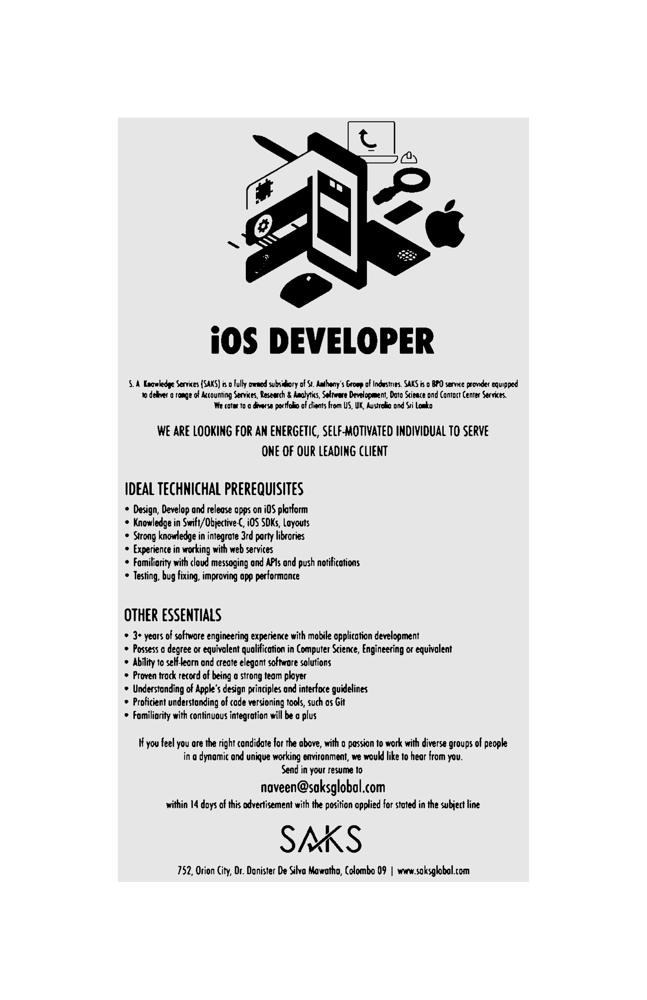

In [41]:
image_with_border = cv2.copyMakeBorder(no_borders, top, bottom, left, right, cv2.BORDER_CONSTANT, value=color)
cv2.imwrite("temp/image_with_border.jpg", image_with_border)
display("temp/image_with_border.jpg")

## 09: Transparency/Alpha Channel 

-------

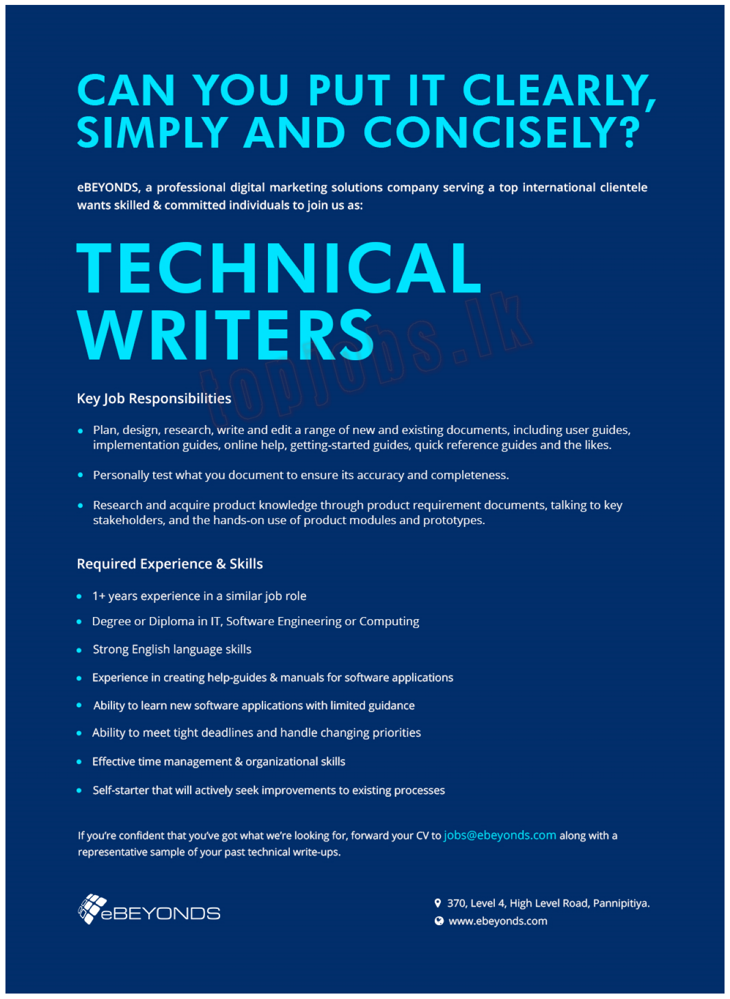

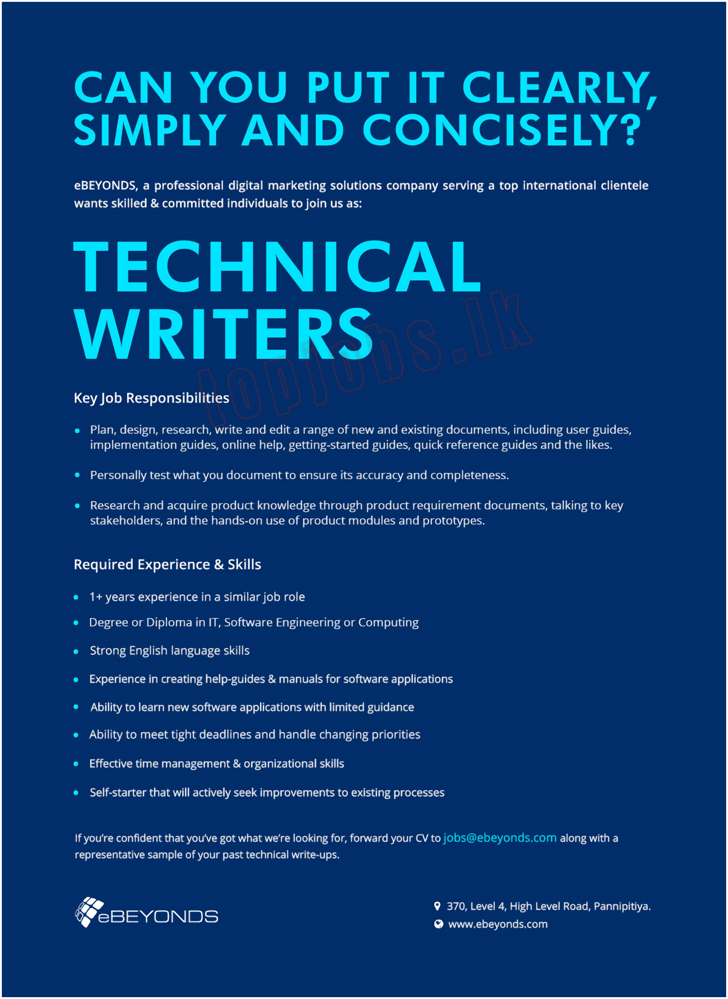

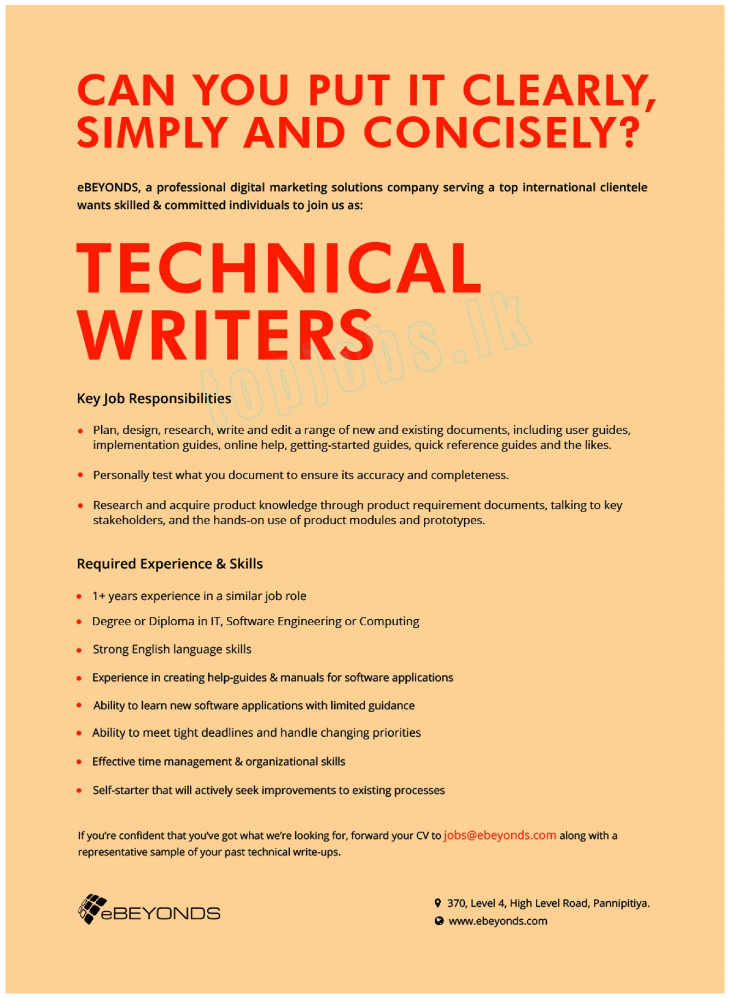

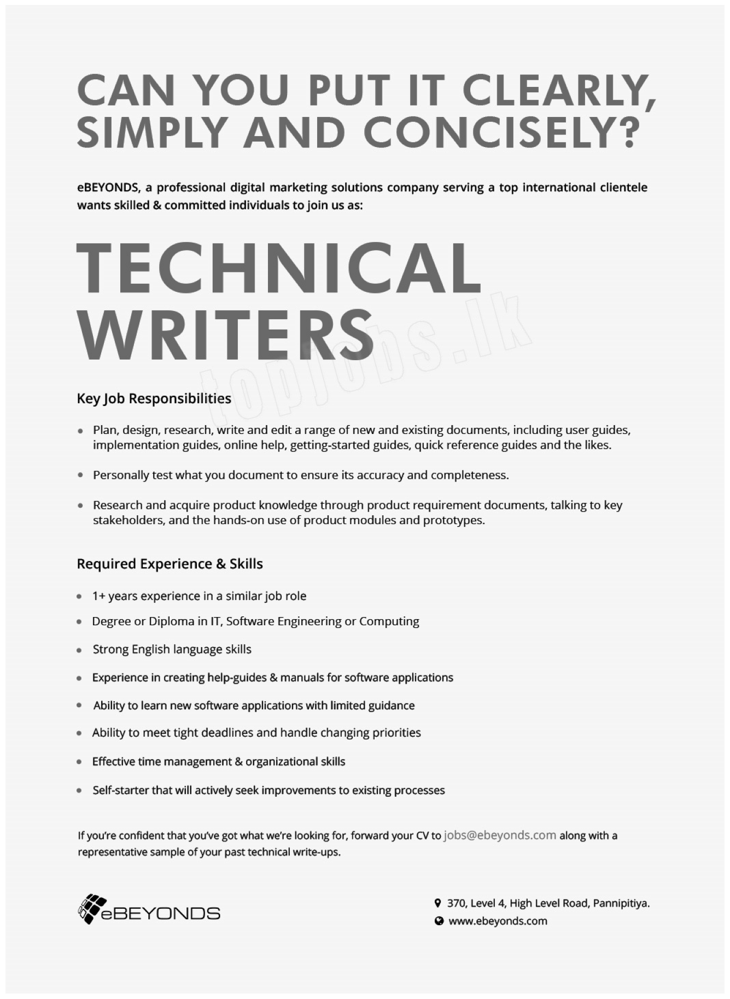

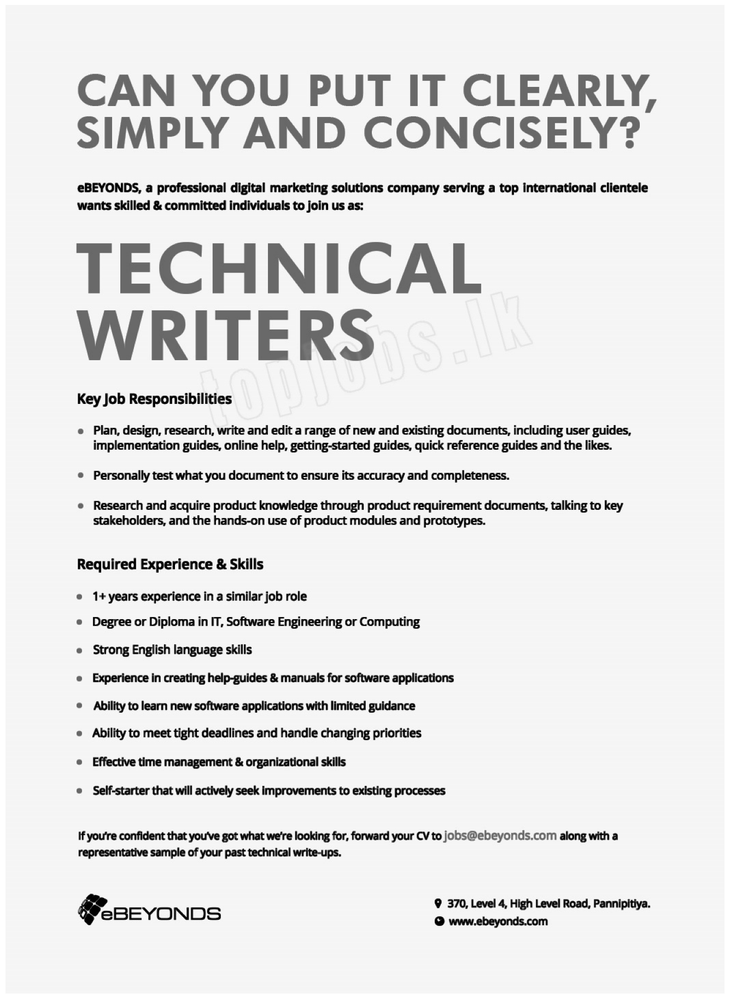